<a href="https://colab.research.google.com/github/estellebordevaire/Projet_Transport_Lyon/blob/main/WCS_Projet_3_Lignes_Bus.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import des librairies

In [ ]:
import pandas as pd
import json
import requests

# Import pour les fichiers GEOJSON

In [ ]:
!apt update
!apt upgrade
!apt install gdal-bin python-gdal python3-gdal 
# Install rtree - Geopandas requirment
!apt install python3-rtree 
# Install Geopandas
!pip install git+git://github.com/geopandas/geopandas.git
# Install descartes - Geopandas requirment
!pip install descartes 

Get:1 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu bionic InRelease [15.9 kB]
Hit:2 http://archive.ubuntu.com/ubuntu bionic InRelease
Get:3 http://archive.ubuntu.com/ubuntu bionic-updates InRelease [88.7 kB]
Get:4 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran40/ InRelease [3,626 B]
Hit:5 http://ppa.launchpad.net/cran/libgit2/ubuntu bionic InRelease
Get:6 http://archive.ubuntu.com/ubuntu bionic-backports InRelease [74.6 kB]
Hit:7 http://ppa.launchpad.net/deadsnakes/ppa/ubuntu bionic InRelease
Get:8 http://ppa.launchpad.net/graphics-drivers/ppa/ubuntu bionic InRelease [21.3 kB]
Get:9 http://security.ubuntu.com/ubuntu bionic-security InRelease [88.7 kB]
Ign:10 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  InRelease
Ign:11 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Get:12 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Release [697 B]
Hit:13 https://developer.

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd
import folium

import rtree

from shapely.geometry import Point
from shapely.ops import transform

from IPython.display import display

# 1.Lignes de bus du réseau Transports en Commun Lyonnais

https://data.grandlyon.com/jeux-de-donnees/lignes-bus-reseau-transports-commun-lyonnais-v2/info


## Lignes de bus (format JSON)

In [ ]:
link = "https://download.data.grandlyon.com/ws/rdata/tcl_sytral.tcllignebus_2_0_0/all.json?maxfeatures=-1"
r = requests.get(link).json()
ligne_bus = pd.json_normalize(r['values'])
ligne_bus.head(5)

,type_trace,gid,destination,pmr,nom_type_ligne,code_type_ligne,nom_version,famille_transport,ligne,code_trace,code_ligne,origine,date_fin,nom_origine,nom_destination,sens,nom_trace,last_update_fme,last_update,code_tri_ligne,date_debut
0,NOM,359,31520,True,Régulière,REG,Avril 2021,BUS,C5,C5-2,C5A,10285,None,Cordeliers,Vancia Château Bérard,Aller,Cordeliers - Vancia Château Bérard,2021-08-07 06:00:24+02:00,2021-05-03 17:09:38+02:00,C 5,20180101
1,NOM,668,31760,True,Régulière,REG,Avril 2021,BUS,ZI4,ZI4-2,ZI4A,10228,None,Caluire Chemin Petit,Vaulx-en-Velin La Soie,Retour,Caluire Chemin Petit - Vaulx-en-Velin La Soie,2021-08-07 06:00:24+02:00,2021-05-03 17:09:38+02:00,Z I4,20180101
2,NOR,741,10487,True,Régulière,REG,Avril 2021,BUS,10,10-2,10D,11147,None,Porte de Lyon,Gare de Vaise,Retour,Porte de Lyon - Gare de Vaise,2021-08-07 06:00:23+02:00,2021-05-03 17:09:38+02:00,10,20200416
3,NOM,742,10524,True,Régulière,REG,Avril 2021,BUS,1E,1E-1,1EX,34351,None,Colombier-Saugn. Salines,Grange Blanche,Aller,Colombier Saugnieu Les Salines - Grange Blanche,2021-08-07 06:00:23+02:00,2021-05-03 17:09:38+02:00,1E,20180101
4,NOM,743,34351,True,Régulière,REG,Avril 2021,BUS,1E,1E-2,1EX,10524,None,Grange Blanche,Colombier-Saugn. Salines,Retour,Grange Blanche - Colombier Saugnieu Les Salines,2021-08-07 06:00:23+02:00,2021-05-03 17:09:38+02:00,1E,20180101


## Lignes de bus (format GEOJSON)

https://data.grandlyon.com/jeux-de-donnees/lignes-bus-reseau-transports-commun-lyonnais-v2/telechargements

Télécharger le fichier au format geoJSON

In [ ]:
# Les geojsons sont des fichiers avec des coordonnées qui correspondent à leur forme géométrique.

bus = "https://download.data.grandlyon.com/wfs/rdata?SERVICE=WFS&VERSION=2.0.0&request=GetFeature&typename=tcl_sytral.tcllignebus_2_0_0&outputFormat=application/json;%20subtype=geojson&SRSNAME=EPSG:4171"
df_bus = gpd.read_file(bus)


In [ ]:
df_bus.head()

,ligne,code_trace,code_ligne,type_trace,nom_trace,sens,origine,destination,nom_origine,nom_destination,famille_transport,date_debut,date_fin,code_type_ligne,nom_type_ligne,pmr,code_tri_ligne,nom_version,last_update,last_update_fme,gid,geometry
0,C5,C5-2,C5A,NOM,Cordeliers - Vancia Château Bérard,Aller,10285,31520,Cordeliers,Vancia Château Bérard,BUS,20180101,,REG,Régulière,true,C 5,Avril 2021,2021-05-03T17:09:38+02:00,2021-08-07T06:00:24+02:00,359,"LINESTRING (4.83656 45.76313, 4.83646 45.76335..."
1,ZI4,ZI4-2,ZI4A,NOM,Caluire Chemin Petit - Vaulx-en-Velin La Soie,Retour,10228,31760,Caluire Chemin Petit,Vaulx-en-Velin La Soie,BUS,20180101,,REG,Régulière,true,Z I4,Avril 2021,2021-05-03T17:09:38+02:00,2021-08-07T06:00:24+02:00,668,"LINESTRING (4.86200 45.80390, 4.86211 45.80394..."
2,10,10-2,10D,NOR,Porte de Lyon - Gare de Vaise,Retour,11147,10487,Porte de Lyon,Gare de Vaise,BUS,20200416,,REG,Régulière,true,10,Avril 2021,2021-05-03T17:09:38+02:00,2021-08-07T06:00:23+02:00,741,"MULTILINESTRING ((4.80531 45.78096, 4.80548 45..."
3,1E,1E-1,1EX,NOM,Colombier Saugnieu Les Salines - Grange Blanche,Aller,34351,10524,Colombier-Saugn. Salines,Grange Blanche,BUS,20180101,,REG,Régulière,true,1E,Avril 2021,2021-05-03T17:09:38+02:00,2021-08-07T06:00:23+02:00,742,"LINESTRING (5.12756 45.71525, 5.12714 45.71522..."
4,20,20-2,20A,NOM,Gare de Vaise - St Cyr,Aller,10487,11294,Gare de Vaise,St Cyr,BUS,20180101,,REG,Régulière,true,20,Avril 2021,2021-05-03T17:09:38+02:00,2021-08-07T06:00:23+02:00,449,"LINESTRING (4.80436 45.78066, 4.80436 45.78066..."


In [ ]:
df_bus["geometry"]

0      LINESTRING (4.83656 45.76313, 4.83646 45.76335...
1      LINESTRING (4.86200 45.80390, 4.86211 45.80394...
2      MULTILINESTRING ((4.80531 45.78096, 4.80548 45...
3      LINESTRING (5.12756 45.71525, 5.12714 45.71522...
4      LINESTRING (4.80436 45.78066, 4.80436 45.78066...
                             ...                        
355    LINESTRING (4.92189 45.76077, 4.92251 45.76094...
356    LINESTRING (4.88204 45.80358, 4.88229 45.80373...
357    LINESTRING (4.96559 45.68236, 4.96576 45.68231...
358    LINESTRING (4.77291 45.58239, 4.77281 45.58237...
359    LINESTRING (4.92315 45.76111, 4.92189 45.76077...
Name: geometry, Length: 360, dtype: geometry

## Alimentation d'une couleur dans df_bus pour distinguer les 3 catégories de bus

In [ ]:
# 3 grandes lignes de bus :
# Lignes de bus au service renforcé (lignes majeures) : Cx : en BLEU et ligne C3 en ROUGE
# Lignes de bus complémentaires : tout le reste : en GRIS
# Lignes de bus spécifiques :
#     S (Soyeuse) : en VERT
#     ZI (Zone Industrielle) : en BORDEAUX 
#     GE (Gare Express) : en BLEU FONCE 
#     R (Résago) : en NOIR 
#     2960 (Intercité) : en NOIR 
#     PL (Pleine Lune) : en BLEU NUIT 
# NB : dans le fichier, on n'a pas les lignes Junior Direct : JD002 à JD762

In [ ]:
df_bus['couleur']=''

In [ ]:
# Lignes de bus au service renforcé : n° de lignes commençant par C
print(len(df_bus[df_bus['ligne'].str.startswith ('C')]))
renforce = df_bus['ligne'].str.startswith('C')
df_bus.loc[renforce, 'couleur'] = "blue"
print(len(df_bus[df_bus["couleur"]=="blue"]))

62
62


In [ ]:
# Lignes de bus au service renforcé : ligne C3 Retour direction Gare Saint Paul (code_trace='C3-2') spécifiquement en ROUGE
print(len(df_bus[df_bus['code_trace']=='C3-2']))
renforce_C3 = df_bus['code_trace']=='C3-2'
df_bus.loc[renforce_C3, 'couleur'] = "red"
print(len(df_bus[df_bus["couleur"]=="red"]))
df_bus_C3 = df_bus[df_bus["couleur"]=="red"]

1
1


In [ ]:
# Lignes de bus spécifiques : PL (Pleine Lune) + lignes commencant par GE, R, S, Z + ligne n°2960
print(len(df_bus[df_bus['ligne'].str.startswith('PL')]))
print(len(df_bus[df_bus['ligne'].str.startswith('GE')]))
print(len(df_bus[df_bus['ligne'].str.startswith('R')]))
print(len(df_bus[df_bus['ligne'].str.startswith('S')]))
print(len(df_bus[df_bus['ligne'].str.startswith('Z')]))
print(len(df_bus[df_bus['ligne'].str.startswith('2960')]))

4
5
6
33
20
2


In [ ]:
# Lignes de bus spécifiques : PL, GE, R, S, Z + ligne n°2960
specifique_PL = df_bus['ligne'].str.startswith('PL') 
df_bus.loc[specifique_PL, 'couleur'] = "#1A5276"  # Bleu Nuit

specifique_GE = df_bus['ligne'].str.startswith('GE') 
df_bus.loc[specifique_GE, 'couleur'] = "#1F618D" # Bleu foncé

specifique_R = df_bus['ligne'].str.startswith('R') 
df_bus.loc[specifique_R, 'couleur'] = "#FF55A3"     #rose brillant

specifique_S = df_bus['ligne'].str.startswith('S') 
df_bus.loc[specifique_S, 'couleur'] = "green"

specifique_Z = df_bus['ligne'].str.startswith('Z') 
df_bus.loc[specifique_Z, 'couleur'] = "#900C3F"   # bordeaux

specifique_inter = df_bus['ligne'].str.startswith('2960') 
df_bus.loc[specifique_inter, 'couleur'] = "black" 

In [ ]:
# Lignes de bus spécifiques : PL, GE, R, S, Z + ligne n°2960
len(df_bus[df_bus["couleur"]=="#1A5276"]) + len(df_bus[df_bus["couleur"]=="#1F618D"]) + len(df_bus[df_bus["couleur"]=="#FF55A3"]) +\
len(df_bus[df_bus["couleur"]=="green"]) + len(df_bus[df_bus["couleur"]=="#900C3F"]) +len(df_bus[df_bus["couleur"]=="black"])

70

In [ ]:
# Lignes de bus complémentaires : tout le reste!
print(len(df_bus[df_bus["couleur"]==""]))
df_bus['couleur'] = df_bus['couleur'].replace("", "#6c6169")    # gris foncé
print(len(df_bus[df_bus["couleur"]=="#6c6169"]))

228
228


# 2. Carte des lignes de bus

## Carte avec plot

<Figure size 1080x720 with 0 Axes>

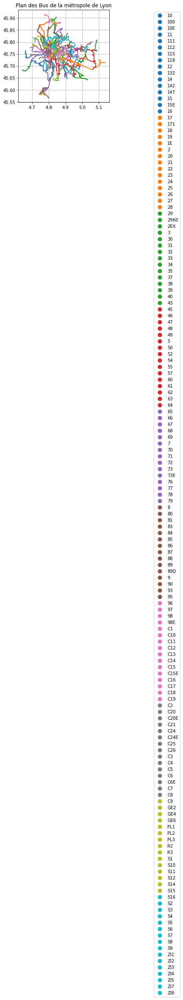

In [ ]:
# affichage à partir d'un geopandas GeoDataFrame
plt.figure(figsize=(15, 10))
legend_param = { "loc": "upper right", "bbox_to_anchor": (1.8, 1)}
df_bus.plot(column = "ligne", legend = True, legend_kwds = legend_param)
plt.title("Plan des Bus de la métropole de Lyon")
plt.grid()
plt.show()

## Carte Folium simple

In [ ]:
# Carte folium
m0 = folium.Map(location = [45.76313,4.83656], zoom_start = 12)
folium.GeoJson(df_bus.geometry).add_to(m0)
m0

## Carte avec l'ensemble des lignes de bus par couleur

In [ ]:
#création de la carte des lignes de bus avec les couleurs et afficher les numéros de ligne quand on passe dessus avec la souris
def style(feature):
    return {'fillColor': feature['properties']['couleur'],
            'color': feature['properties']['couleur'],
            'weight': 3}

m1 = folium.Map(location = [45.76313,4.83656], zoom_start = 12)
folium.GeoJson(data=df_bus, style_function=style, tooltip=folium.features.GeoJsonTooltip(fields=['ligne', 'nom_trace'], localize=True)).add_to(m1)
folium.GeoJson(data=df_bus_C3, style_function=style, tooltip=folium.features.GeoJsonTooltip(fields=['ligne', 'nom_trace'], localize=True)).add_to(m1)
m1

# la fonction style_function : permet d'appliquer les couleurs sur les lignes
# le paramètre tooltip permet d'afficher le numéro de la ligne lorsque l'on passe dessus avec la souris
# créer un df spécifique pour la ligne C3 permet d'avoir toute la ligne en rouge sur la carte (car plusieurs lignes se superposent)

## Carte avec regroupement par famille de bus

In [ ]:
df_renforce = df_bus[df_bus["couleur"]=="blue"]
df_specifique = pd.concat([df_bus[df_bus["couleur"]=="#1A5276"], df_bus[df_bus["couleur"]=="#1F618D"], df_bus[df_bus["couleur"]=="#FF55A3"],\
                           df_bus[df_bus["couleur"]=="green"], df_bus[df_bus["couleur"]=="#900C3F"], df_bus[df_bus["couleur"]=="black"]], ignore_index=True)
df_complementaire = df_bus[df_bus["couleur"]=="#6c6169"]

In [ ]:
# Import du logo BUS, l'image doit être copiée au préalable dans le répertoire Images en local
from google.colab import files
data = files.upload()

Saving 1280px-Lyon_tcl_logo-bus.png to 1280px-Lyon_tcl_logo-bus.png


In [ ]:
# Ajout de groupes par catégorie de bus ainsi que des markers au départ et à l'arrivée de la ligne C3

from folium.plugins import MarkerCluster

layer = folium.FeatureGroup(name='Your layer with Markers', show=False)

def style(feature):
        return {
            'fillColor': feature['properties']['couleur'],
            'color': feature['properties']['couleur'],
            'weight': 3}

m2=folium.Map(location = [45.76313,4.83656], zoom_start = 12)

# Groupe : bus specifique
bus_specifique = folium.FeatureGroup(name="Service Spécifique")
#cluster1 = MarkerCluster().add_to(bus_specifique)
bus_specifique.add_to(m2)
folium.GeoJson(data=df_specifique, style_function=style, tooltip=folium.features.GeoJsonTooltip(fields=['ligne', 'nom_trace'], localize=True)).add_to(bus_specifique)

# Groupe : bus complementaire
bus_complementaire = folium.FeatureGroup(name="Service Complementaire")
#cluster2 = MarkerCluster().add_to(bus_complementaire)
folium.GeoJson(data=df_complementaire, style_function=style, tooltip=folium.features.GeoJsonTooltip(fields=['ligne', 'nom_trace'], localize=True)).add_to(bus_complementaire)
bus_complementaire.add_to(m2)

# Groupe : service renforcé
bus_renforce = folium.FeatureGroup(name="Service Renforcé")
#cluster3 = MarkerCluster().add_to(bus_renforce)
folium.GeoJson(data=df_renforce, style_function=style, tooltip=folium.features.GeoJsonTooltip(fields=['ligne', 'nom_trace'], localize=True)).add_to(bus_renforce)
folium.GeoJson(data=df_bus_C3, style_function=style, tooltip=folium.features.GeoJsonTooltip(fields=['ligne', 'nom_trace'], localize=True)).add_to(bus_renforce)
bus_renforce.add_to(m2)


# Ajout des logos de début et arrivée de la ligne C3
locationDepart = [45.789073,4.912546]
iconDepart= folium.features.CustomIcon("/content/1280px-Lyon_tcl_logo-bus.png", icon_size=(20, 20), icon_anchor=(10, 10))
popupDepart = "Ligne : <br><strong>C3</strong><br>Départ : <br><strong>Vaulx - La Grappiniere</strong>"
folium.Marker(location=locationDepart, tooltip=popupDepart, icon=iconDepart).add_to(layer)

locationArrivee = [45.766281,4.827037]
iconArrivee= folium.features.CustomIcon("/content/1280px-Lyon_tcl_logo-bus.png", icon_size=(20, 20), icon_anchor=(10, 10)) 
popupArrivee = "Ligne : <br><strong>C3</strong><br>Arrivée : <br><strong>Gare Saint-Paul</strong>"                                                                                      
folium.Marker(location=locationArrivee, tooltip=popupArrivee, icon=iconArrivee).add_to(layer)

layer.add_to(bus_renforce) 

folium.LayerControl().add_to(m2)
m2

# MArkerCluster permet de regrouper des markers

In [ ]:
m2.save('Reseau_bus.html')

In [ ]:
from google.colab import files
files.download('Reseau_bus.html')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# 3. Prise en compte des points d'arrêts

## Points d'arrêts (format JSON)

https://download.data.grandlyon.com/ws/rdata/tcl_sytral.tclarret/all.json

In [ ]:
link = 'https://download.data.grandlyon.com/ws/rdata/tcl_sytral.tclarret/all.json?maxfeatures=-1'
data1 = requests.get(link).json()

In [ ]:
point_arret = pd.json_normalize(data1['values'])
print(point_arret.shape)
point_arret.sort_values('id')

(4687, 9)


,nom,escalator,pmr,desserte,last_update,ascenseur,gid,last_update_fme,id
2268,24 Aout,False,True,"87A:A,ZI1A:A",2021-08-03 02:31:25,False,792,2021-08-03 06:00:15,1
2269,24 Aout,False,True,"87A:R,ZI1A:R",2021-08-03 02:31:25,False,791,2021-08-03 06:00:15,2
2270,4 Chemins - La Salette,False,True,"C20D:A,C20E:A",2021-08-03 02:31:25,False,793,2021-08-03 06:00:15,3
2271,4 Chemins - La Salette,False,True,90B:A,2021-08-03 02:31:25,False,797,2021-08-03 06:00:15,5
2272,4 Chemins - La Salette,False,True,90B:R,2021-08-03 02:31:25,False,796,2021-08-03 06:00:15,6
...,...,...,...,...,...,...,...,...,...
175,St-Genis Lycee Paillot,False,False,78B:A,2021-08-03 02:31:25,False,11016,2021-08-03 06:00:19,47854
176,St-Genis Lycee Paillot,False,False,78B:R,2021-08-03 02:31:25,False,11017,2021-08-03 06:00:19,47855
62,Jardin des Plantes,False,False,S6A:A,2021-08-03 02:31:25,False,10980,2021-08-03 06:00:19,47856
63,Trois Renards,False,False,5A:A,2021-08-03 02:31:25,False,11058,2021-08-03 06:00:19,47863


## Points d'arrêts (format GEOJSON)

In [ ]:
# Import du fichier geojson
link='https://download.data.grandlyon.com/wfs/rdata?SERVICE=WFS&VERSION=2.0.0&request=GetFeature&typename=tcl_sytral.tclarret&outputFormat=application/json;%20subtype=geojson&SRSNAME=EPSG:4171'
df_arret = gpd.read_file(link)
df_arret.head(20)

,id,nom,desserte,pmr,ascenseur,escalator,gid,last_update,last_update_fme,geometry
0,47600,Mermoz - Pinel,C15E:A,true,false,false,11039,2021-08-07T02:31:23,2021-08-07T06:00:15,POINT (4.88692 45.73062)
1,47671,Foucaud - Picasso,57A:A,false,false,false,11026,2021-08-07T02:31:23,2021-08-07T06:00:15,POINT (4.92325 45.77400)
2,47719,Charbonnieres Tennis,GE6A:A,false,false,false,11063,2021-08-07T02:31:23,2021-08-07T06:00:15,POINT (4.74661 45.78249)
3,47720,Beckensteiner,GE6A:A,false,false,false,11064,2021-08-07T02:31:23,2021-08-07T06:00:15,POINT (4.74597 45.77962)
4,47721,Charbonnieres Cimetiere,GE6A:A,false,false,false,11065,2021-08-07T02:31:23,2021-08-07T06:00:15,POINT (4.74474 45.78564)
5,47737,Tassin Centre social,5A:A,false,false,false,11057,2021-08-07T02:31:23,2021-08-07T06:00:15,POINT (4.76688 45.76351)
6,47784,Les Halles 102 - 104,"5A:A,86A:A",false,false,false,10753,2021-08-07T02:31:23,2021-08-07T06:00:15,POINT (4.75174 45.77715)
7,47785,Les Halles 102 - 104,"5A:R,86A:R",false,false,false,10754,2021-08-07T02:31:23,2021-08-07T06:00:15,POINT (4.75163 45.77701)
8,47796,Rochette Cercle d'Aviron,S5A:A,false,false,false,10881,2021-08-07T02:31:23,2021-08-07T06:00:15,POINT (4.82362 45.79112)
9,47837,Montibert-Aquagaron,12B:A,false,false,false,11005,2021-08-07T02:31:23,2021-08-07T06:00:15,POINT (4.76481 45.68293)


In [ ]:
type(df_arret)

geopandas.geodataframe.GeoDataFrame

In [ ]:
# On ne conserve que les dessertes contenant la ligne C3
df_arret_C3 = df_arret[df_arret['desserte'].str.contains("C3A:R")]
df_arret_C3['ligne']='C3'
print(len(df_arret_C3))
df_arret_C3.head()

29


/usr/local/lib/python3.7/dist-packages/geopandas/geodataframe.py:1330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


,id,nom,desserte,pmr,ascenseur,escalator,gid,last_update,last_update_fme,geometry,ligne
505,10300,Mas du Taureau,"52A:A,C3A:R",false,false,false,2166,2021-08-07T02:31:23,2021-08-07T06:00:12,POINT (4.91128 45.78519),C3
626,36014,Vaulx - La Grappiniere,"52A:A,52A:R,C3A:A,C3A:R",true,false,false,9720,2021-08-07T02:31:23,2021-08-07T06:00:13,POINT (4.91251 45.78846),C3
654,1784,Lesire,"52A:A,C3A:R",true,false,false,2068,2021-08-07T02:31:23,2021-08-07T06:00:12,POINT (4.91378 45.78081),C3
859,1508,Laurent Bonnevay,"C3A:A,C3A:R",true,false,false,236,2021-08-07T02:31:23,2021-08-07T06:00:11,POINT (4.90885 45.76487),C3
1019,1190,Hôtel de Ville L. Pradel,"C13B:A,C14A:A,C3A:R,PL2A:A",false,false,false,113,2021-08-07T02:31:23,2021-08-07T06:00:11,POINT (4.83609 45.76720),C3


In [ ]:
df_arret_C3['id'].unique()

array(['10300', '36014', '1784', '1508', '1190', '46307', '46290', '1596',
       '46735', '1513', '2500', '47118', '47144', '664', '1071', '47121',
       '2982', '47208', '47326', '47327', '33468', '30000', '36999',
       '11515', '33062', '33469', '47001', '47003', '47030'], dtype=object)

In [ ]:
# Pour récupérer ce fichier au format csv
#df_arret_C3.to_csv('point_arret_C3R.csv')

# 4. Carte de la ligne C3 avec points d'arrêt et délais prochain passage

## Affichage de la ligne C3

In [ ]:
# Prise en compte de la couleur attribuée à la ligne avec l'option style_function
def style(feature):
        return {
            'fillColor': feature['properties']['couleur'],
            'color': feature['properties']['couleur'],
            'weight': 5
        }

m3 = folium.Map(location = [45.76313,4.83656], zoom_start = 12)
folium.GeoJson(data=df_bus_C3, style_function=style, tooltip=folium.features.GeoJsonTooltip(fields=['ligne', 'nom_trace'], localize=True)).add_to(m3)
m3

# la fonction style_function : permet d'appliquer les couleurs sur les lignes
# le paramètre tooltip permet d'afficher le numéro de la ligne lorsque l'on passe dessus avec la souris

## Ajout de Markers

In [ ]:
# Markers par défaut
folium.GeoJson(data=df_arret_C3).add_to(m3)
m3

In [ ]:
# Markers bus

# this is the layer that eventually gets added to Map
layer = folium.FeatureGroup(name='Your layer with Markers', show=False)

    # load GEOJSON, but don't add it to anything
gj = folium.GeoJson(data=df_arret_C3)

    # iterate over GEOJSON features, pull out point coordinates, make Markers and add to layer
for feature in gj.data['features']:
  if feature['geometry']['type'] == 'Point':
    folium.Marker(location=list(reversed(feature['geometry']['coordinates'])),
                          icon=folium.Icon(
                              icon_color='blue',
                              icon='bus',
                              prefix='fa'),
                         # popup=feature['properties']['nom']
                      tooltip= folium.Tooltip(feature['properties']['nom'])
                          ).add_to(layer)

layer.add_to(m3)
m3

## Ligne C3 avec points d'arrets

In [ ]:
# Import du logo BUS, l'image doit être copiée au préalable dans le répertoire Images en local
from google.colab import files
data = files.upload()

Saving 1280px-Lyon_tcl_logo-bus.png to 1280px-Lyon_tcl_logo-bus.png


In [ ]:
# Carte de la ligne de bus C3 :
def style(feature):
        return {
            'fillColor': feature['properties']['couleur'],
            'color': feature['properties']['couleur'],
            'weight': 5
        }

m4=folium.Map(location = [45.76313,4.83656], zoom_start = 13)
#folium.GeoJson(data=df_bus_C3, style_function=style, tooltip=folium.features.GeoJsonTooltip(fields=['ligne', 'nom_trace'], localize=True)).add_to(m3)
folium.GeoJson(data=df_bus_C3, style_function=style, tooltip=folium.features.GeoJsonTooltip(fields=['ligne'], localize=True)).add_to(m4)


# Ajout des points d'arrêts des bus sur la carte matérialisés par des cercles et non des marqueurs

# this is the layer that eventually gets added to Map
layer = folium.FeatureGroup(name='Your layer with Markers', show=False)

    # load GEOJSON, but don't add it to anything
gj = folium.GeoJson(data=df_arret_C3)

    # iterate over GEOJSON features, pull out point coordinates, make Markers and add to layer
for feature in gj.data['features']:
  if feature['geometry']['type'] == 'Point':
    folium.Circle(location=list(reversed(feature['geometry']['coordinates'])),
                          color="white",
                          fill=True,
                          fill_color="white",
                          fill_opacity=1,
                          radius=10,
                          #popup=feature['properties']['nom']
                          tooltip= folium.Tooltip(feature['properties']['nom']),
                          ).add_to(layer)

# Ajout des marqueurs de début et de fin ligne
locationDepart = [45.789073,4.912546]
iconDepart= folium.features.CustomIcon("/content/1280px-Lyon_tcl_logo-bus.png", icon_size=(20, 20), icon_anchor=(10, 10))
popupDepart = "C3 Vaulx - La Grappiniere"
folium.Marker(location=locationDepart, tooltip=popupDepart, icon=iconDepart).add_to(layer)

locationArrivee = [45.766281,4.827037]
iconArrivee= folium.features.CustomIcon("/content/1280px-Lyon_tcl_logo-bus.png", icon_size=(20, 20), icon_anchor=(10, 10)) 
popupArrivee = "C3 Gare Saint-Paul"                                                                                     
folium.Marker(location=locationArrivee, tooltip=popupArrivee, icon=iconArrivee).add_to(layer)

layer.add_to(m4)                                                                                           
m4

# Import des données de prochain passage

In [ ]:
import requests
from requests.auth import HTTPBasicAuth
import pandas as pd

In [ ]:
username = 'estellebordevaire@yahoo.fr'
password = 'projet3WCS!'
url = 'https://download.data.grandlyon.com/ws/rdata/tcl_sytral.tclpassagearret/all.json?maxfeatures=-1&start=1'

r=requests.get(url, auth=HTTPBasicAuth(username, password))
data=r.json()
df_passage=pd.json_normalize(data["values"])

In [ ]:
print(df_passage.shape)
df_passage.head()

(10793, 10)


,idtarretdestination,coursetheorique,direction,ligne,delaipassage,heurepassage,gid,last_update_fme,type,id
0,35998,87A-0326M:1:1:33,Mions Bourdelle,87A,13 min,2021-08-07 17:23:00,1,2021-08-07 17:09:32,E,1
1,35998,87A-0326M:2:1:20,Mions Bourdelle,87A,48 min,2021-08-07 17:58:00,2,2021-08-07 17:09:32,E,1
2,11315,87A-0326M:2:1:19,Gare de VÃ©nissieux,87A,22 min,2021-08-07 17:32:10,3,2021-08-07 17:09:32,E,2
3,11315,87A-0326M:1:1:35,Gare de VÃ©nissieux,87A,57 min,2021-08-07 18:07:10,4,2021-08-07 17:09:32,E,2
4,367,C20B-1026Y:6:1:12,Francheville Taffignon,C20D,9 min,2021-08-07 17:18:49,5,2021-08-07 17:09:32,E,3


In [ ]:
# Selection de la ligne C3 et du sens de circulation
df_passage_C3 = df_passage[df_passage['ligne']=='C3A']
df_passage_C3 = df_passage_C3[df_passage_C3['idtarretdestination']==30000]
df_passage_C3 = df_passage_C3.sort_values('id')
print(len(df_passage_C3))
df_passage_C3.head()

50


,idtarretdestination,coursetheorique,direction,ligne,delaipassage,heurepassage,gid,last_update_fme,type,id
927,30000,C3A-0276@:3:1:23,Gare Saint-Paul,C3A,3 min,2021-08-07 17:12:39,928,2021-08-07 17:09:33,E,664
928,30000,C3A-0276@:13:1:15,Gare Saint-Paul,C3A,11 min,2021-08-07 17:20:39,929,2021-08-07 17:09:33,E,664
1446,30000,C3A-0276@:3:1:23,Gare Saint-Paul,C3A,Proche,2021-08-07 17:09:42,1447,2021-08-07 17:09:34,E,1071
1447,30000,C3A-0276@:13:1:15,Gare Saint-Paul,C3A,8 min,2021-08-07 17:17:42,1448,2021-08-07 17:09:34,E,1071
1584,30000,C3A-0276@:12:1:15,Gare Saint-Paul,C3A,4 min,2021-08-07 17:13:45,1585,2021-08-07 17:09:34,T,1190


In [ ]:
# On remplace tous les "Proche" par "0 min"
def fonc_proche(delai):
  if delai=="Proche":
    delai= '0 min'
  return delai
df_passage_C3['delaipassage'] = df_passage_C3['delaipassage'].apply(fonc_proche)

In [ ]:
df_passage_C3.reset_index(inplace=True)
df_passage_C3.drop(columns='index', inplace=True)
df_passage_C3 = df_passage_C3.sort_values("id")
df_passage_C3.head()

,idtarretdestination,coursetheorique,direction,ligne,delaipassage,heurepassage,gid,last_update_fme,type,id
0,30000,C3A-0276@:3:1:23,Gare Saint-Paul,C3A,3 min,2021-08-07 17:12:39,928,2021-08-07 17:09:33,E,664
1,30000,C3A-0276@:13:1:15,Gare Saint-Paul,C3A,11 min,2021-08-07 17:20:39,929,2021-08-07 17:09:33,E,664
2,30000,C3A-0276@:3:1:23,Gare Saint-Paul,C3A,0 min,2021-08-07 17:09:42,1447,2021-08-07 17:09:34,E,1071
3,30000,C3A-0276@:13:1:15,Gare Saint-Paul,C3A,8 min,2021-08-07 17:17:42,1448,2021-08-07 17:09:34,E,1071
4,30000,C3A-0276@:12:1:15,Gare Saint-Paul,C3A,4 min,2021-08-07 17:13:45,1585,2021-08-07 17:09:34,T,1190


In [ ]:
# On ne conserve que le prochain bus :
df_passage_C3 = df_passage_C3.drop_duplicates(subset=['id'], keep='first')
df_passage_C3.head()

,idtarretdestination,coursetheorique,direction,ligne,delaipassage,heurepassage,gid,last_update_fme,type,id
0,30000,C3A-0276@:3:1:23,Gare Saint-Paul,C3A,3 min,2021-08-07 17:12:39,928,2021-08-07 17:09:33,E,664
2,30000,C3A-0276@:3:1:23,Gare Saint-Paul,C3A,0 min,2021-08-07 17:09:42,1447,2021-08-07 17:09:34,E,1071
4,30000,C3A-0276@:12:1:15,Gare Saint-Paul,C3A,4 min,2021-08-07 17:13:45,1585,2021-08-07 17:09:34,T,1190
6,30000,C3A-0276@:3:1:23,Gare Saint-Paul,C3A,9 min,2021-08-07 17:19:00,2032,2021-08-07 17:09:34,E,1508
8,30000,C3A-0276@:3:1:23,Gare Saint-Paul,C3A,5 min,2021-08-07 17:14:15,2177,2021-08-07 17:09:34,E,1596


In [ ]:
# On convertit l'id en int :
df_arret_C3['id'] = df_arret_C3['id'].astype(int)
df_arret_C3.info()
df_arret_C3.head()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 29 entries, 505 to 4662
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype   
---  ------           --------------  -----   
 0   id               29 non-null     int64   
 1   nom              29 non-null     object  
 2   desserte         29 non-null     object  
 3   pmr              29 non-null     object  
 4   ascenseur        29 non-null     object  
 5   escalator        29 non-null     object  
 6   gid              29 non-null     object  
 7   last_update      29 non-null     object  
 8   last_update_fme  29 non-null     object  
 9   geometry         29 non-null     geometry
 10  ligne            29 non-null     object  
dtypes: geometry(1), int64(1), object(9)
memory usage: 2.7+ KB


/usr/local/lib/python3.7/dist-packages/geopandas/geodataframe.py:1330: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


,id,nom,desserte,pmr,ascenseur,escalator,gid,last_update,last_update_fme,geometry,ligne
505,10300,Mas du Taureau,"52A:A,C3A:R",false,false,false,2166,2021-08-07T02:31:23,2021-08-07T06:00:12,POINT (4.91128 45.78519),C3
626,36014,Vaulx - La Grappiniere,"52A:A,52A:R,C3A:A,C3A:R",true,false,false,9720,2021-08-07T02:31:23,2021-08-07T06:00:13,POINT (4.91251 45.78846),C3
654,1784,Lesire,"52A:A,C3A:R",true,false,false,2068,2021-08-07T02:31:23,2021-08-07T06:00:12,POINT (4.91378 45.78081),C3
859,1508,Laurent Bonnevay,"C3A:A,C3A:R",true,false,false,236,2021-08-07T02:31:23,2021-08-07T06:00:11,POINT (4.90885 45.76487),C3
1019,1190,Hôtel de Ville L. Pradel,"C13B:A,C14A:A,C3A:R,PL2A:A",false,false,false,113,2021-08-07T02:31:23,2021-08-07T06:00:11,POINT (4.83609 45.76720),C3


In [ ]:
# On ajoute le delai de passage dans df_arret_C3
df_arret_C3 = df_arret_C3.merge(df_passage_C3, on = 'id', how='left')
df_arret_C3.head()

,id,nom,desserte,pmr,ascenseur,escalator,gid_x,last_update,last_update_fme_x,geometry,ligne_x,idtarretdestination,coursetheorique,direction,ligne_y,delaipassage,heurepassage,gid_y,last_update_fme_y,type
0,10300,Mas du Taureau,"52A:A,C3A:R",false,false,false,2166,2021-08-07T02:31:23,2021-08-07T06:00:12,POINT (4.91128 45.78519),C3,30000.0,C3A-0276@:13:1:15,Gare Saint-Paul,C3A,5 min,2021-08-07 17:14:20,4836.0,2021-08-07 17:09:37,E
1,36014,Vaulx - La Grappiniere,"52A:A,52A:R,C3A:A,C3A:R",true,false,false,9720,2021-08-07T02:31:23,2021-08-07T06:00:13,POINT (4.91251 45.78846),C3,30000.0,C3A-0276@:13:1:15,Gare Saint-Paul,C3A,2 min,2021-08-07 17:12:00,7322.0,2021-08-07 17:09:39,T
2,1784,Lesire,"52A:A,C3A:R",true,false,false,2068,2021-08-07T02:31:23,2021-08-07T06:00:12,POINT (4.91378 45.78081),C3,30000.0,C3A-0276@:13:1:15,Gare Saint-Paul,C3A,7 min,2021-08-07 17:16:14,2478.0,2021-08-07 17:09:35,E
3,1508,Laurent Bonnevay,"C3A:A,C3A:R",true,false,false,236,2021-08-07T02:31:23,2021-08-07T06:00:11,POINT (4.90885 45.76487),C3,30000.0,C3A-0276@:3:1:23,Gare Saint-Paul,C3A,9 min,2021-08-07 17:19:00,2032.0,2021-08-07 17:09:34,E
4,1190,Hôtel de Ville L. Pradel,"C13B:A,C14A:A,C3A:R,PL2A:A",false,false,false,113,2021-08-07T02:31:23,2021-08-07T06:00:11,POINT (4.83609 45.76720),C3,30000.0,C3A-0276@:12:1:15,Gare Saint-Paul,C3A,4 min,2021-08-07 17:13:45,1585.0,2021-08-07 17:09:34,T


In [ ]:
folium.GeoJson(data=df_arret_C3).data['features']

[{'bbox': [4.911284987664556,
   45.78519248559993,
   4.911284987664556,
   45.78519248559993],
  'geometry': {'coordinates': [4.911284987664556, 45.78519248559993],
   'type': 'Point'},
  'id': '0',
  'properties': {'ascenseur': 'false',
   'coursetheorique': 'C3A-0276@:13:1:15',
   'delaipassage': '5 min',
   'desserte': '52A:A,C3A:R',
   'direction': 'Gare Saint-Paul',
   'escalator': 'false',
   'gid_x': '2166',
   'gid_y': 4836.0,
   'heurepassage': '2021-08-07 17:14:20',
   'id': 10300,
   'idtarretdestination': 30000.0,
   'last_update': '2021-08-07T02:31:23',
   'last_update_fme_x': '2021-08-07T06:00:12',
   'last_update_fme_y': '2021-08-07 17:09:37',
   'ligne_x': 'C3',
   'ligne_y': 'C3A',
   'nom': 'Mas du Taureau',
   'pmr': 'false',
   'type': 'E'},
  'type': 'Feature'},
 {'bbox': [4.912506111769049,
   45.78846371112667,
   4.912506111769049,
   45.78846371112667],
  'geometry': {'coordinates': [4.912506111769049, 45.78846371112667],
   'type': 'Point'},
  'id': '1',
  '

## Ligne C3 avec points d'arrets et information du délai de passage à chaque arrêt

In [ ]:
# Carte
def style(feature):
        return {
            'fillColor': feature['properties']['couleur'],
            'color': feature['properties']['couleur'],
            'weight': 5
        }

m5=folium.Map(location = [45.76313,4.83656], zoom_start = 13)

folium.GeoJson(data=df_bus_C3, style_function=style, tooltip=folium.features.GeoJsonTooltip(fields=['ligne'], localize=True)).add_to(m5)

# Ajout des points d'arrêts des bus sur la carte matérialisés par des cercles et non des marqueurs

    # this is the layer that eventually gets added to Map
layer = folium.FeatureGroup(name='Your layer with Markers', show=False)

    # load GEOJSON, but don't add it to anything
gj = folium.GeoJson(data=df_arret_C3)

    # iterate over GEOJSON features, pull out point coordinates, make Markers and add to layer
for feature in gj.data['features']:
  if feature['geometry']['type'] == 'Point':
      folium.Circle(location=list(reversed(feature['geometry']['coordinates'])),
                          color="white",
                          fill=True,
                          fill_color="white",
                          fill_opacity=1,
                          radius=10,
                          #popup=feature['properties']['nom']
                          #popup=f"Prochain passage : <strong>{feature['properties']['delaipassage']}</strong>",
                          tooltip= folium.Tooltip(f"Arrêt : <br><strong>{feature['properties']['nom']}</strong><br>Prochain passage : <br><strong>{feature['properties']['delaipassage']}</strong>"),
                          ).add_to(layer)

# Ajout des marqueurs de début et de fin ligne
locationDepart = [45.789073,4.912546]
iconDepart= folium.features.CustomIcon("/content/1280px-Lyon_tcl_logo-bus.png", icon_size=(20, 20), icon_anchor=(10, 10))
popupDepart = "Ligne : <br><strong>C3</strong><br>Départ : <br><strong>Vaulx - La Grappiniere</strong>"
folium.Marker(location=locationDepart, tooltip=popupDepart, icon=iconDepart).add_to(layer)

locationArrivee = [45.766281,4.827037]
iconArrivee= folium.features.CustomIcon("/content/1280px-Lyon_tcl_logo-bus.png", icon_size=(20, 20), icon_anchor=(10, 10)) 
popupArrivee = "Ligne : <br><strong>C3</strong><br>Arrivée : <br><strong>Gare Saint-Paul</strong>"                                                                                     
folium.Marker(location=locationArrivee, tooltip=popupArrivee, icon=iconArrivee).add_to(layer)

# Ajout d'un popup à l'arrêt Terreaux La Feuillee avec le délai d'attente du prochain bus :
#folium.Marker(location=[45.76732, 4.83121], popup=f"Prochain passage : <strong>{passage1}</strong>").add_to(layer)

layer.add_to(m5)                                                                                           
m5

In [ ]:
m5.save('Projet_carte_C3.html')

In [ ]:
from google.colab import files
files.download('Projet_carte_C3.html')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Import des arrondissements de Lyon (non utilisé)

In [ ]:
# Import du fichier geojson
link = "https://download.data.grandlyon.com/wfs/grandlyon?SERVICE=WFS&VERSION=2.0.0&request=GetFeature&typename=adr_voie_lieu.adrarrond&outputFormat=application/json;%20subtype=geojson&SRSNAME=EPSG:4171"
df_arrond = gpd.read_file(link)
df_arrond.head(20)

,nom,nomreduit,insee,libofficiel,gid,geometry
0,LYON 7EME,LYON 7,69387,Lyon 7e Arrondissement,1,"POLYGON ((4.83770 45.70737, 4.83764 45.70740, ..."
1,LYON 8EME,LYON 8,69388,Lyon 8e Arrondissement,2,"POLYGON ((4.84879 45.71885, 4.84858 45.71926, ..."
2,LYON 6EME,LYON 6,69386,Lyon 6e Arrondissement,3,"POLYGON ((4.86994 45.76373, 4.86703 45.76373, ..."
3,LYON 4EME,LYON 4,69384,Lyon 4e Arrondissement,4,"POLYGON ((4.81856 45.78944, 4.81892 45.78973, ..."
4,LYON 9EME,LYON 9,69389,Lyon 9e Arrondissement,5,"POLYGON ((4.81088 45.78099, 4.81042 45.78020, ..."
5,LYON 1ER,LYON 1,69381,Lyon 1er Arrondissement,6,"POLYGON ((4.83049 45.76454, 4.82948 45.76645, ..."
6,LYON 3EME,LYON 3,69383,Lyon 3e Arrondissement,7,"POLYGON ((4.83901 45.75660, 4.83842 45.75677, ..."
7,LYON 5EME,LYON 5,69385,Lyon 5e Arrondissement,8,"POLYGON ((4.81353 45.74819, 4.81339 45.74800, ..."
8,LYON 2EME,LYON 2,69382,Lyon 2e Arrondissement,9,"POLYGON ((4.81782 45.72649, 4.81737 45.72909, ..."


In [ ]:
import plotly.express as px
import geopandas as gpd

m6 = folium.Map(location = [45.76313,4.83656], zoom_start = 12)
folium.GeoJson(df_bus_C3R.geometry).add_to(m6)
m6.choropleth(geo_data=df_arrond)
m6

/usr/local/lib/python3.7/dist-packages/folium/folium.py:426: FutureWarning:

The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.

